On résout Vlasov-HMF en décomposant $f=g+h$, avec $g$ dont l'évolution sera suivie en SL et $h$ en PIC.

$$
\{h+g, H[h+g]\} = \{h, \frac{v^2}{2} + \phi[h+g]\} + \{g, \frac{v^2}{2} + \phi[h+g]\}
$$

On fait ensuite un splitting sur $h$ et $g$ pour les faire évoluer :
 - STEP1 : $t \to t+\frac{\Delta t}{2}$ : $\partial_t g =  -v \partial_x g + \partial_x \phi[g^t + h^t] \partial_v g$.<br>
    Cette étape permet également de connaitre $\partial_x\phi[g^t + h^t]$ grâce à la FFT. A priori c'est plus précis que 
    d'approcher $g^t+h^t$ par des dirac et ensuite d'estimer $\partial_x \phi$, mais c'est à tester !<br>
    Derrière ça l'idée est que $h$ n'est qu'une perturbation de $g$, donc l'information importante du couple $(g,h)$ est
    $g$ et qu'on souhaite la garder intacte pour être le plus précis.
 - STEP2 : $t \to t+\Delta t$ : $\partial_t h =  -v \partial_x h + \partial_x \phi[g^{t+\Delta t/2} + h^t] \partial_v h$
 - STEP3 : $t+\frac{\Delta t}{2} \to t + \Delta t$ : $\partial_t g =  -v \partial_x g + \partial_x \phi[g^{t + \Delta t/2} + h^{t+\Delta t}] \partial_v g$

In [26]:
using LinearAlgebra, QuadGK, Roots, FFTW
using VlasovSolvers
using Plots

import VlasovSolvers: advection!
import VlasovSolvers: samples, Particles, PIC_step!, compute_rho
using ProgressMeter

In [27]:
"""
    hmf_poisson!(fᵗ    :: Array{Complex{Float64},2},
                 mesh1 :: OneDGrid,
                 mesh2 :: OneDGrid,
                 ex    :: Array{Float64})

    Compute the electric hamiltonian mean field from the
    transposed distribution function

"""
function hmf_poisson!(fᵗ::Array{Complex{Float64},2},
        mesh1::OneDGrid,
        mesh2::OneDGrid,
        ex::Array{Float64})

    n1 = mesh1.len
    rho = mesh2.step .* vec(sum(fᵗ, dims=1)) # ≈ ∫ f(t,x_i,v)dv, i=1, ..., n1
    rho .-= sum(rho) * mesh1.step / mesh1.stop
    kernel = zeros(Float64, n1)
    k = -(mesh1.stop - mesh1.start) / (2π)
    kernel[2]   =  k    # fourier mode  1
    kernel[end] = -k    # fourier mode -1
    ex .= real(ifft(fft(rho) .* 1im .* kernel))
end

hmf_poisson!

In [28]:
"""
    hmf_poisson_pic!(fᵗ    :: Array{Complex{Float64},2},
                 mesh1 :: OneDGrid,
                 mesh2 :: OneDGrid,
                 ex    :: Array{Float64})

    Compute the electric hamiltonian mean field from the
    transposed distribution function

"""
function hmf_poisson_pic!(fᵗ::Array{Complex{Float64},2},
        particles::Particles,
        mesh1::OneDGrid,
        mesh2::OneDGrid,
        ex::Array{Float64})

    n1 = mesh1.len
    rho = vec(sum(fᵗ, dims=1)) * mesh2.step # ≈ ∫ f(t,x_i,v)dv, i=1, ..., n1
    rho_pic = compute_rho(particles, mesh1)[1]
    rho += ComplexF64.(rho_pic)    # PIC contribution
    rho .-= sum(rho) * mesh1.step / mesh1.stop
    kernel = zeros(Float64, n1)
    k = -(mesh1.stop - mesh1.start) / (2π)
    kernel[2]   =  k    # fourier mode  1
    kernel[end] = -k    # fourier mode -1
    ex .= real(ifft(fft(rho) .* 1im .* kernel))
end

hmf_poisson_pic!

In [29]:
function solve_SL!(nsteps, dt, f, mesh1, mesh2; plotting=false::Bool)
    n1, n2 = size(f)
    fᵗ = zeros(Complex{Float64}, (n2,n1))
    transpose!(fᵗ, f)

    energy = Array{Float64}(undef, nsteps)

    ex = zeros(Float64, n1)
    hmf_poisson!(fᵗ, mesh1, mesh2, ex)
    advection!(fᵗ, mesh2, ex, 0.5dt)

    progression = ProgressMeter.Progress(nsteps,desc="Loop in time: ", showspeed=true)
    
    animation = @animate for istep = 1:nsteps
        energy[istep] = sqrt(sum(ex.^2) * mesh1.step)
    
        if plotting
            plot(mesh1.points, mesh2.points, real(f)', size=(500, 500), st=:surface, camera=(0, 90))
            title!("Progression: $(round(Int64,100*progression.counter / progression.n))%")
        end
        advection!(f, mesh1, v, dt)
        transpose!(fᵗ, f)
        hmf_poisson!(fᵗ, mesh1, mesh2, ex)
        advection!(fᵗ, mesh2, ex, dt)
        transpose!(f, fᵗ) 
        ProgressMeter.next!(progression)
    end
    if plotting
        return energy, ex, animation
    else
        return energy, ex, nothing
    end
end

solve_SL! (generic function with 2 methods)

In [30]:
function solve_SL!(nsteps, dt, f, mesh1, mesh2, particles::Particles)
    n1, n2 = size(f)
    fᵗ = zeros(Complex{Float64}, (n2,n1))
    transpose!(fᵗ, f)

    energy = Array{Float64}(undef, nsteps)

    ex = zeros(Float64, n1)
    hmf_poisson_pic!(fᵗ, particles, mesh1, mesh2, ex)
    advection!(fᵗ, mesh2, ex, 0.5dt)

    for istep = 1:nsteps
        energy[istep] = sqrt(sum(ex.^2) * mesh1.step)

        advection!(f, mesh1, mesh2.points, dt)
        transpose!(fᵗ, f)
        hmf_poisson_pic!(fᵗ, particles, mesh1, mesh2, ex)
        advection!(fᵗ, mesh2, ex, dt)
        transpose!(f, fᵗ) 
    end
    return energy, ex
end

solve_SL! (generic function with 2 methods)

In [31]:
function solve_PIC!(nsteps, dt, particles, meshx)
    potential = []
    energy_elec_from_phi = []
    energy_pic = []
    energy_hamil_elec = []
    energy_hamil_cine = []
    energy_tot = []
    L = meshx.stop
    np = length(p.x)
    progression = ProgressMeter.Progress(nsteps,desc="Loop in time: ", showspeed=true)
    for istep = 1:nsteps # Loop over time
        e1, e2, e3 = PIC_step!(p, meshx, dt)
        push!(energy_hamil_elec, e1)
        push!(energy_pic, e2)
        push!(energy_elec_from_phi, e3)
        
        ProgressMeter.next!(progression)
    end
    return energy_hamil_elec, energy_pic, energy_elec_from_phi
end

solve_PIC! (generic function with 1 method)

In [32]:
function projection_onto_grid(particles, meshx, meshv)
    projection = zeros(Float64, meshx.len, meshv.len)
    for ipart = 1:particles.nbpart
        idxgridx = Int64(fld(p.x[ipart],                meshx.step)) + 1
        idxgridv = Int64(fld(p.v[ipart] - meshv.start,  meshv.step)) + 1
        idxgridxp1 = idxgridx<meshx.len ? idxgridx+1 : 1
        idxgridvp1 = idxgridv<meshv.len ? idxgridv+1 : 1
        
        tx = (p.x[ipart]                - (idxgridx-1) * meshx.step) / meshx.step
        tv = (p.v[ipart] - meshv.start  - (idxgridv-1) * meshv.step) / meshv.step

        projection[idxgridx  , idxgridv  ] += p.wei[ipart] * (1-tx) * (1-tv)
        projection[idxgridx  , idxgridvp1] += p.wei[ipart] * (1-tx) * tv
        projection[idxgridxp1, idxgridvp1] += p.wei[ipart] * tx     * tv
        projection[idxgridxp1, idxgridv  ] += p.wei[ipart] * tx     * (1 - tv)
    end
    return projection ./ (meshx.step * meshv.step)
end

projection_onto_grid (generic function with 1 method)

In [33]:
function solve_SL_PIC!(nsteps, dt, f, mesh1, mesh2, particles; plotting=false::Bool)
    _, dphidx = solve_SL!(1, dt/2, f, mesh1, mesh2, particles)
    energy = Array{Float64}(undef, nsteps)
    progression = ProgressMeter.Progress(nsteps,desc="Loop in time: ", showspeed=true)
    animation = @animate for istep = 1:nsteps
        if plotting
            pic_sl = real(f) .+ projection_onto_grid(particles, mesh1, mesh2)
            plot(mesh1.points, mesh2.points, pic_sl', size=(500, 500), st=:surface, camera=(0, 90))
            title!("Progression: $(round(Int64,100*progression.counter / progression.n))%")
        end

        energy[istep] = sqrt(sum(dphidx.^2) * mesh1.step)
        PIC_step!(p, mesh1, mesh2, dt, dphidx)
        _, dphidx = solve_SL!(1, dt, f, mesh1, mesh2, particles)
        ProgressMeter.next!(progression)
    end
    if plotting
        return energy, animation
    else
        return energy,  nothing
    end
end

solve_SL_PIC! (generic function with 1 method)

# Inputs

In [34]:
dev = CPU()

nsteps = 1000
dt = 0.05

ϵ = 0.1
kx = 0.5
L = 2π/kx

β = 1.0
μ = -2.0
μp = μ + 5.0
βp = β * 15
κ = 0.8

0.8

In [35]:
#= Semi-Lagrangian data =#
mesh1slpic = OneDGrid(dev, 32, 0, 2π / kx)
mesh2slpic = OneDGrid(dev, 64, -10, 10)

n1, delta1 = mesh1slpic.len, mesh1slpic.step
n2, delta2 = mesh2slpic.len, mesh2slpic.step
x, v = mesh1slpic.points, mesh2slpic.points'

#======= PIC data =======#
np = 5_000 # number of particles
@time (x0, y0, wei) = samples(np, kx, ϵ, μp, βp) # bump-on-tail
p = Particles(x0, y0, wei, np);
p.wei .= κ / np * √(2π/βp) / (κ*√(2π/βp) + √(2π/β));

  0.003802 seconds (10.02 k allocations: 1.069 MiB)


# Vérification du sampling

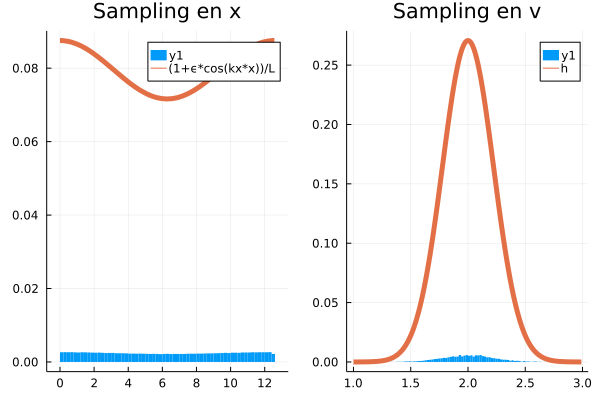

In [36]:
p1=histogram(p.x, bins=100, lw=0., weights=p.wei)
plot!(p1, x -> (1 + ϵ*cos(kx*x)) / L, 0, L, lw=5, label="(1+ϵ*cos(kx*x))/L")
title!(p1, "Sampling en x")

p2=histogram(p.v, bins=100, lw=0., weights=p.wei)
arrv = (μp-1):10^-2:(μp+1)
hv = v -> exp(-βp*(v-μp)^2 / 2) * κ / (√(2π/β) + κ * √(2π / βp))
plot!(p2, arrv, hv.(arrv), lw=5, label="h")
title!(p2, "Sampling en v")

plot(p1, p2)

In [37]:
g  = zeros(Complex{Float64}, (n1,n2))
@. g = (1.0+ϵ*cos(kx*x)) / L  * exp(-β*(v-μ)^2 / 2) / (κ*√(2π/βp) + √(2π/β)); # main part of distribution
∫g = sum(g) * mesh1slpic.step * mesh2slpic.step

0.8482588448347278 + 0.0im

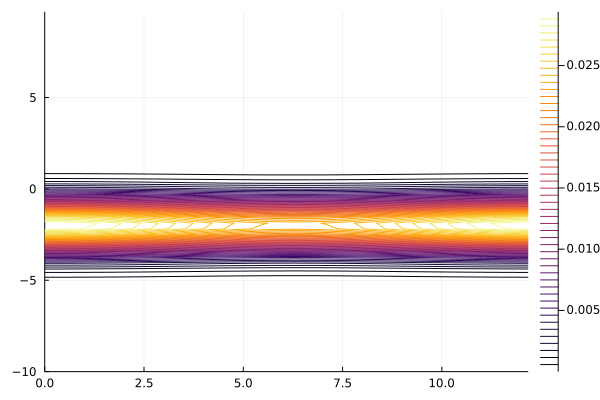

In [38]:
contour(mesh1slpic.points, mesh2slpic.points, real(g)', levels=50)

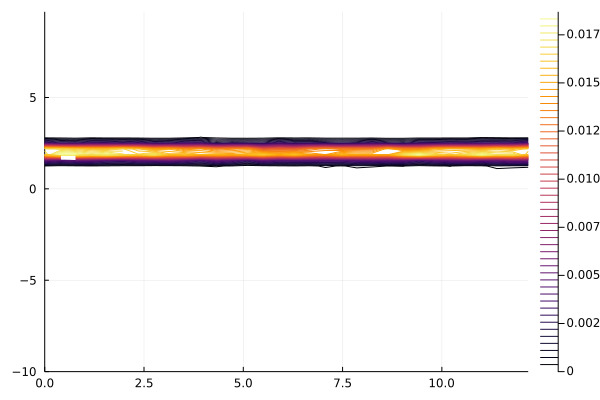

In [39]:
contour(mesh1slpic.points, mesh2slpic.points, projection_onto_grid(p, mesh1slpic, mesh2slpic)', levels=50)

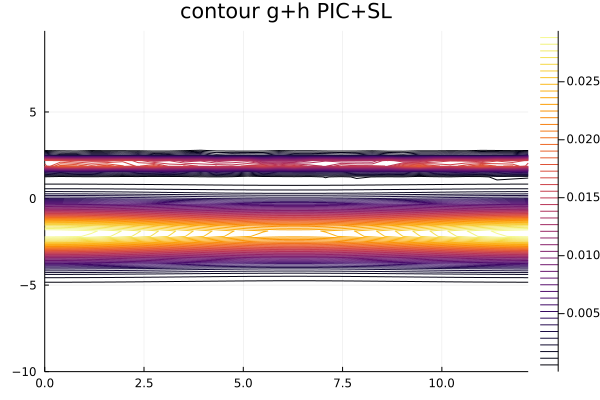

In [40]:
contour(mesh1slpic.points, mesh2slpic.points, projection_onto_grid(p, mesh1slpic, mesh2slpic)' .+ real(g)', levels=50)
title!("contour g+h PIC+SL")

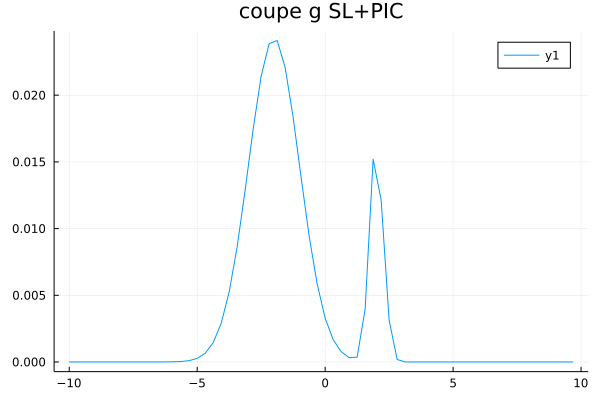

In [41]:
plot(mesh2slpic.points, (projection_onto_grid(p, mesh1slpic, mesh2slpic) .+ real(g))[Int64(mesh1slpic.len/2), :])
title!("coupe g SL+PIC")

In [42]:
sum(real(g) .+ projection_onto_grid(p, mesh1slpic, mesh2slpic)) * mesh1slpic.step * mesh2slpic.step

0.9999999999999996

In [43]:
mesh1sl = OneDGrid(dev, 128, 0, 2π / kx)
mesh2sl = OneDGrid(dev, 256, -10, 10)

n1, delta1 = mesh1sl.len, mesh1sl.step
n2, delta2 = mesh2sl.len, mesh2sl.step
x, v = mesh1sl.points, mesh2sl.points'


gref  = zeros(Complex{Float64}, (n1,n2))
@. gref = (1.0+ϵ*cos(kx*x)) / L * (exp(-β*(v-μ)^2 / 2) + κ * exp(-βp*(v-μp)^2 / 2)) / (κ*√(2π/βp) + √(2π/β)); 

In [44]:
sum(real(gref)) * (mesh1sl.step * mesh2sl.step)

0.9999999999999996

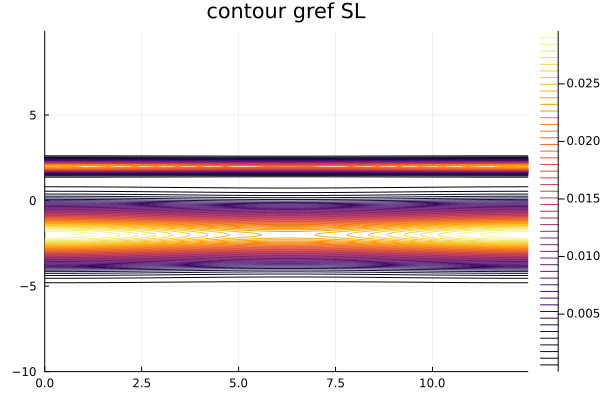

In [45]:
contour(mesh1sl.points, mesh2sl.points, real(gref)', levels=50)
title!("contour gref SL")

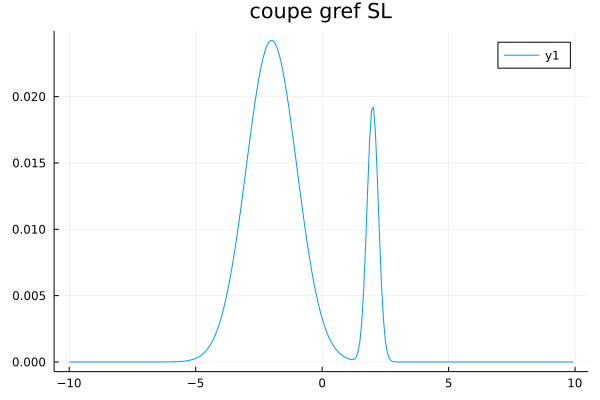

In [46]:
plot(mesh2sl.points, real(gref[Int64(mesh1sl.len/2), :]))
title!("coupe gref SL")

In [47]:
# Needs to have the same grids for sl and slpic:
# ======
# L2normdiff = sqrt(sum((real(gref) .- (real(g) + projection_onto_grid(p, mesh1slpic, mesh2slpic))).^2))
# println("L2-norm of difference between reference and g+h: $(L2normdiff)")
# plot(x, v, (real(gref) .- (real(g) + projection_onto_grid(p, mesh1slpic, mesh2slpic)))', st=:surface)

# Make simulations and create gifs

Loop in time: 100%|███████████████████████| Time: 0:01:13 (73.11 ms/it)
┌ Info: Saved animation to 
│   fn = /Users/ylehenaf/Documents/julia/VlasovSolvers.jl/src/sl_pic.gif
└ @ Plots /Users/ylehenaf/.julia/packages/Plots/AJMX6/src/animation.jl:114


Plots.AnimatedGif("/Users/ylehenaf/Documents/julia/VlasovSolvers.jl/src/sl_pic.gif")
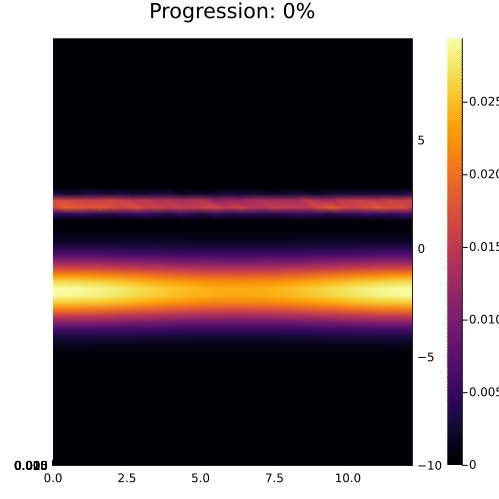

In [48]:
Eslpic, animationslpic = solve_SL_PIC!(nsteps, dt, g, mesh1slpic, mesh2slpic, p, plotting=true);
if animationslpic != nothing
    gif(animationslpic, "sl_pic.gif")
end

Loop in time: 100%|███████████████████████| Time: 0:01:05 (65.10 ms/it)
┌ Info: Saved animation to 
│   fn = /Users/ylehenaf/Documents/julia/VlasovSolvers.jl/src/refined_sl.gif
└ @ Plots /Users/ylehenaf/.julia/packages/Plots/AJMX6/src/animation.jl:114


Plots.AnimatedGif("/Users/ylehenaf/Documents/julia/VlasovSolvers.jl/src/refined_sl.gif")
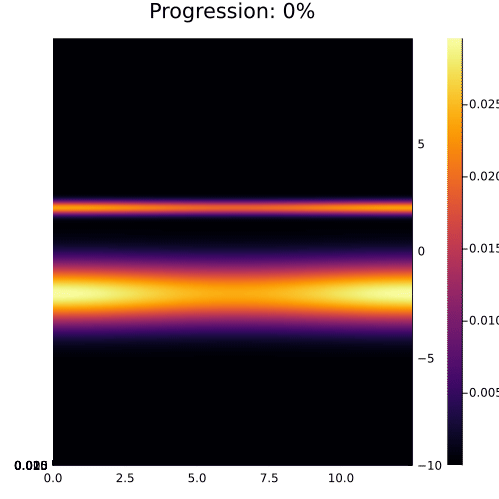

In [49]:
Esl, _, animationsl = solve_SL!(nsteps, dt, gref, mesh1sl, mesh2sl; plotting=true);
if animationsl != nothing
    gif(animationsl, "refined_sl.gif")
end

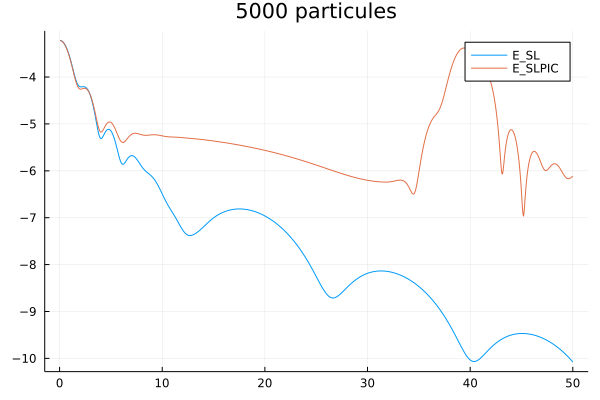

In [50]:
t = (1:nsteps).*dt

plot(t, log.(Esl), label="E_SL")
plot!(t, log.(Eslpic), label="E_SLPIC")
title!("$(np) particules")

# TODO: 

 - Exemples théoriques de bump on tail, regarder relations de dispersion.
 - Calculer Phi_PIC avec méthodes PIC au lieu de tout sommer puis fourier

 [x] vérifier normalisations et poids particules -> il fallait normaliser aussi par dx, dv le poids des particules.
 [x] Comparer solve_SL_PIC avec PIC quand on met g=0 et avec SL quand on met p.wei.=0, $\kappa=0$ -> OK

 - 
 - Comparer SL petit maillage vs. (SL gros maillage + PIC) vs. PIC.
 - Regarder l'évolution des tourbillons générés par PIC -> augmenter $\kappa$ ?